# Rigorozní odhady prvního vlastního čísla p-laplaciánu 

## varianta $u_1$, $u_2$

Řešíme úlohu 
\begin{equation}
-\Delta_p u =\lambda |u|^{p-2}u, \; t \in (0,1)\\
u(0)=u(1)=0
\end{equation}
kde $\Delta_p u := \left(|u'|^{p-2}u' \right)'$.

Přesná hodnota prvního vlastního čísla je:

$$\lambda_1 = (p-1)\left( \frac{2\frac{\pi/p}{\sin{\pi/p}}}{b-a} \right)^p,$$

přesná hodnota první vlastní funkce:

$$e_p =(p-1)^{-\frac{1}{p}} \sin_p{\left( \pi_p\frac{x-a}{b-a} \right)}$$


![vl-cislo-fce](vl-cislo-fce.png)

### Algoritmus:
1. úlohu vyřešit numericky metodou střelby
2. získané řešení $u_1 := u$ a $u_2 := |u_1'|^{p-2}u_1'$ proložit intervalově křivkou (kubický spline?)
3. $v$ zderivovat - půjde snadno, je to polynom
4. dosadit do vztahu pro horní/dolní odhad a intervalově vypočítat

#### Postup pro řešení pomocí shooting method:
- převedu na soustavu:
\begin{equation}
u_1' = |u_2|^{\frac{p}{p-1}-2} u_2\\
u_2' = -\lambda |u_1|^{p-2}u_1
\end{equation}
- tu řeším jako IVP s levou okrajovou podmínkou a nějakým pevným $\lambda$
- bisekcí měním $\lambda$ až se napravo dostanu kam potřebuju ($u_1=0$)


#### Problémy:
- je vůbec možné použít $u_2$? Je to zaručená derivace vnitřku $\Delta_p u$?
- u kubického splinu pro $u_1$ chci nastavit duhou derivaci na $-1$. Co to ale znamená pro křivku proloženou numerickým řešení $u_2$ vzhledem k $p$ a $\Delta_p$?

---
### Poznámky

**Přesnost výsledků (ověřeno na p=1.5)**
- nejlepších výsledků dosahuju s co nejmenším poštem dělení řešení (=3), kdy je výsledné intervalové řešení piconeho co nejvíce podobné "parabole" a nemá ádné zákmity na stranách
- otázka ale je, jestli nejde nějak odstranit ty zákmity i jinak (nějakým přesnějším dělením, které něčemu odpovídá, nějakkou jinou hodnotou druhé derivace v krajích při tvorbě splinu apod.)

---> to řešení není totiž pořád moc přesný, je dost daleko od skutečného

**Jak stanovit $\alpha$?**
- u p=1.5 se zdálo, že dává smysl $10(p-1)\alpha \lambda_1$. Ale p=3 to nefunguje. udu uset zase ověřit experimentálně ===> tohle posunutí asi dává smysl, funguje i u dalších případů!!!


**Hodně dělit řešení a álo jednotlivé oblouky**
- Odzkoušeno jen na základních příkladech p=1.ř a 3, ale zdá se, že obrácený postup (více dělit oblouky a řešení dělit jen málo) funguje o maličko lépe 


### TODO

- v cyklu zkusit různé dělení
- je třeba ale správně nastavovat $\alpha$ to ovšem zjistim až po průchodu splinem - udělat pár iterací a donastavit to --> stačí vzít poslední element (nebo možná nejmenší) a posunout o dolní hranici nahoru, tedy $inf(minimum(u1)\cdot 1.01$ (např, pokud je záporné, pokud kladné násobím $0.99$)

In [2]:
using DifferentialEquations
using Plots; gr()
using IntervalArithmetic
using DataInterpolations
using LinearAlgebra
using ForwardDiff

Nejprve si nastavím $p=3$. Zatím pracuji jen s $p>2$ a s $p \in \mathbb{N}$.

In [3]:
# nastavení p a přesná hodnota λ₁
P=1.5
λ1 = (P-1)*(2*(π/P)/(sin(π/P)))^P

5.318718076379169

In [10]:
# nastavení základních parametrů

#####VYZKOUŠET TYHLE HODNOTY
#tn = 1002 # kroků dělení
#xn = 1 # dělení jednotlivého oblouku spline

tn = 21 # kroků dělení
xn = 3#1002 # dělení jednotlivého oblouku spline


α = 0.001-0.00094+6.4e-5+0.0004-0.0005-3.13323e-06+0.00415-0.0041157 # - 7e-4 - 2.4e-4 + 7.44e-5+ 1.92e-5 + 5.98e-5 + 5.23e-5-0.00018 # kolik budeme přičítat k řešení
α = 0.01-0.009-0.0009
#dd = 

a,b = (3.,8.); # interval na kterém hledá λ₁ (nesmí obsahovat i λ₂, jinak to můž najít to)

Numerické řešení přes střelbu. 

Počáteční podmínka nastavena na $\boldsymbol{u}_0 = (0, 1)$, časový krok $\Delta t = 0.01$

---

Zatím to vypadá, že řešení IVP v Julii funguje jen pro P>=2 (případ P=2 nás ale vlastně nezajímá). Zjistit, proš nefunguje řešení pro 1<P<2

- důvod je v tom, že počáteční podmínka pro $u_1$ je $u_1(0)=0$ a tak v druhé rovnici hned na začátku dělím nulou. Řešením je to trochu posunout nahoru, ale to je pak řešení úplně blbě. Zkusím to ještě konfigurací řešiče
    - možná by stačilo nějak řešiči říct, ať to _neřeší_ v prvním bodě, někdo to v těch parametrech bylo
    
řešení:
- stačilo předělat rovnice na sgn, čímž jsem se zbavil pitomého exponentu p-2 a taky správně nastavit iniciální odhad na $\lambda_1$

Numericky získané první vlastní číslo λ₁: 5.318718074184005
Chyba proti přesnému řešení: 2.195164050533549e-9


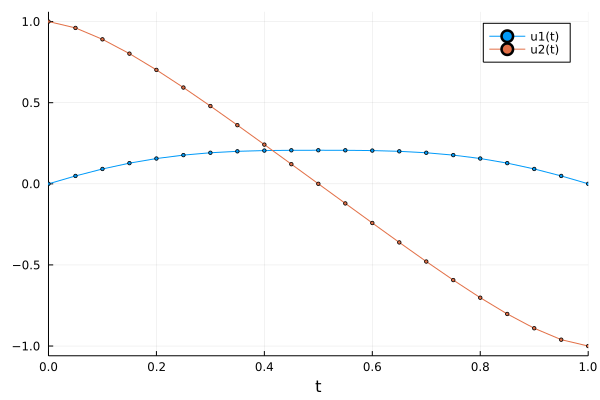

In [11]:
# řešení diferenciální soustavy metodou střelby

function sl(du,u,p,t) # parametr p je odhad na λ₁ a p z p-laplacianu
    λ, r = p
    du[1] = abs(u[2])^(1/(r-1)) * sign(u[2])
	du[2] = -λ * abs(u[1])^(r-1)*sign(u[1]) # abs mohu pro u₁ vynechat, protože je vždy kladné
end

u0 = [0.0; 1.0;] # počáteční podmínka

s = (a + b)/2
ts = 1.0/(tn-1) # velikost intervalu dělení


e = 1e-12 # zastavovací podmínka

while (b-a) >= e
    prob = ODEProblem(sl, u0, (0.0, 1.0), (s, P))
    sol = solve(prob, saveat=ts, abstol=1e-8,reltol=1e-8)

    if sol(1)[1] == 0 # bere hodnotu v t=1 (pravej konec) pro první řešení soustavy u₁
        break
    else
        probA = ODEProblem(sl, u0, (0.0, 1.0), (a, P))
        solA = solve(probA, saveat=ts, abstol=1e-8,reltol=1e-8)
        
        probS = ODEProblem(sl, u0, (0.0, 1.0), (s, P))
        solS = solve(probS, saveat=ts, abstol=1e-8,reltol=1e-8)

        if solA(1)[1] * solS(1)[1] < 0
            b = s
        else
            a = s
        end
        s = (a+b)/2
    end
end
    
prob = ODEProblem(sl, u0, (0.0, 1.0), (s, P))
sol = solve(prob, saveat=ts, abstol=1e-8,reltol=1e-8)

println("Numericky získané první vlastní číslo λ₁: $s")
println("Chyba proti přesnému řešení: $(λ1-s)")
plot(sol,marker=2)

Vytáhnu si řešení do proměnných t, a u2. 

---> zatím ne: K u1 přičtu nějakou malou hodnotu aby posléze spline nelezl intervalově pod $0$. 

In [12]:


t = sol.t
ti = [@interval(i) for i in t]

u2 = [u[2] for u in sol.u]
u2i = [@interval(u[2]) for u in sol.u];




Intervalově vypočítáme kubický spline pro numerické řešení $u_2$.

In [13]:
#matice A
n=length(u2i)
dv = [4..4 for i in 1:n-2]
ev = [1..1 for i in 1:n-3]
A = Array(SymTridiagonal(dv,ev))
A_inv = inv(A) #inverze

#pravá strana
h = ts
# sestavení pravé strany
rhs = []
for i in 3:length(u2i)
    append!(rhs, 6/h^2 * (u2i[i] - 2 * u2i[i-1] + u2i[i-2]))
end

# vypočte vektor druhých derivací potřebný na výpočet koeficientů
# druhá derivace na krajích je nastavena na -1

d2v = []
#append!(d2v, @interval(10*(P-1)*α*s)) # druhou derivaci nastavíme na přihbližnou hodnotu λ₁
append!(d2v, @interval(-9.988)) # druhou derivaci nastavíme na přihbližnou hodnotu λ₁
append!(d2v, A_inv*rhs)
append!(d2v, @interval(10.131))#-1));

# výpočet koeficientů jednotlivých oblouků splinu
csc_u2 = [] #@interval zeros(4, length(solu)-1)
for i in 1:length(u2i)-1
    a=b=c=d=0
    a = (d2v[i+1]-d2v[i])/(6*h)
    b = d2v[i]/2 
    c = (u2i[i+1] - u2i[i])/h - h*(2*d2v[i]+d2v[i+1])/6
    d = u2i[i]
    append!(csc_u2, [[a,b,c,d]])
    #csc[1, i] = a
end
csc_u2

20-element Vector{Any}:
 Interval{Float64}[[-24.5031, -24.503], [-4.99401, -4.99399], [-0.475659, -0.475658], [1, 1]]
 Interval{Float64}[[41.0096, 41.0097], [-8.66946, -8.66945], [-1.0756, -1.07559], [0.960669, 0.96067]]
 Interval{Float64}[[-0.63646, -0.636459], [-2.51802, -2.51801], [-1.63498, -1.63497], [0.890341, 0.890342]]
 Interval{Float64}[[6.88981, 6.88982], [-2.61349, -2.61348], [-1.89155, -1.89154], [0.802218, 0.802219]]
 Interval{Float64}[[3.06763, 3.06764], [-1.58001, -1.58], [-2.10123, -2.10122], [0.701968, 0.701969]]
 Interval{Float64}[[2.90237, 2.90238], [-1.11987, -1.11986], [-2.23622, -2.23621], [0.593341, 0.593342]]
 Interval{Float64}[[2.02098, 2.02099], [-0.684507, -0.684506], [-2.32644, -2.32643], [0.479093, 0.479094]]
 Interval{Float64}[[1.44685, 1.44686], [-0.381359, -0.381358], [-2.37973, -2.37972], [0.361313, 0.361314]]
 Interval{Float64}[[0.870204, 0.870205], [-0.164331, -0.16433], [-2.40702, -2.40701], [0.241554, 0.241555]]
 Interval{Float64}[[0.225293, 0.22529

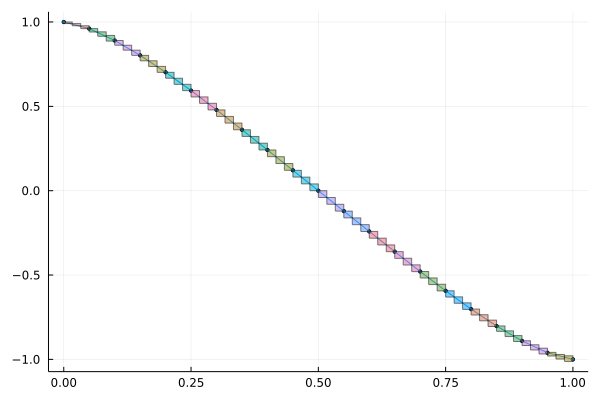

In [20]:
# napočítání a
# vykreslení řešení aproximovaného přes kubický spline



p = plot(t,u2, marker=2)
u2spl = Interval[]
for i in 1:length(u2i)-1
    x_dom = t[i]..t[i+1] # domain # range(0,1,length=n)
    x_int = mince(x_dom,xn)
    f(x) = csc_u2[i][1]*(x-ti[i])^3 + csc_u2[i][2]*(x-ti[i])^2 + csc_u2[i][3]*(x-ti[i]) + csc_u2[i][4]
    append!(u2spl, f.(x_int))
    boxes = IntervalBox.(x_int, f.(x_int))    
    plot!(boxes, legend=false)
end

tints=mince(0..1, length(u2spl))
p

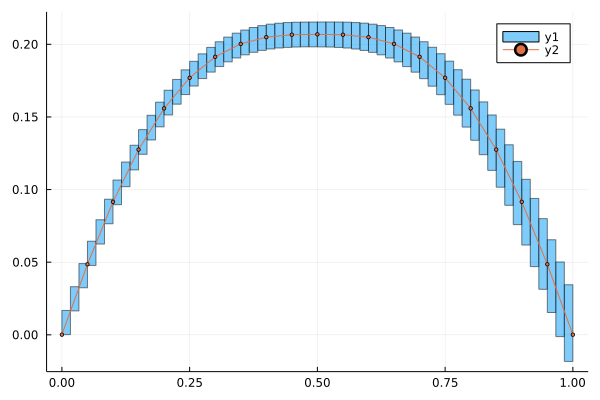

In [21]:
f(x) = abs(x)^(1/(P-1))*sign(x)
#sum(f.(u2spl) .* diam.(tints))

u1tmp = Interval[0..0]
for i in 1:length(u2spl)
    append!(u1tmp, u1tmp[end] + f(u2spl[i]) * diam(tints[i]))
end

u1int = Interval[]
for i in 1:length(u1tmp)-1
    append!(u1int, u1tmp[i] ∪ u1tmp[i+1])
end

u1int = u1int .+ α

boxes = IntervalBox.(tints, u1int)
plot(boxes)
plot!(t, [u[1]+α for u in sol.u], marker=2)


In [22]:
u1int

60-element Vector{Interval{Float64}}:
  [0.0001, 0.0167667]
  [0.0164538, 0.0331206]
  [0.0323851, 0.0490518]
  [0.0477665, 0.0644393]
  [0.0625036, 0.0792241]
  [0.0764688, 0.0933403]
  [0.0895737, 0.106553]
  [0.101969, 0.118948]
  [0.113534, 0.130513]
  [0.12426, 0.14124]
  [0.134141, 0.151127]
  [0.143176, 0.160183]
  [0.151375, 0.168396]
   ⋮
  [0.133924, 0.168573]
  [0.124003, 0.160372]
  [0.113202, 0.151368]
  [0.101617, 0.141558]
  [0.0891592, 0.130852]
  [0.0758395, 0.119347]
  [0.0618065, 0.107056]
  [0.0469558, 0.0938699]
  [0.031346, 0.0799687]
  [0.0153356, 0.0654475]
 [-0.00125836, 0.0501431]
 [-0.0183289, 0.0344459]

In [23]:
# spočítat druhou derivaci u2spl z koeficientů = p-laplacian
csc_u2der =[ [@interval(3) * cs[1], @interval(2) * cs[2], cs[3]] for cs in csc_u2 ]

20-element Vector{Vector{Interval{Float64}}}:
 [[-73.5091, -73.509], [-9.98801, -9.98799], [-0.475659, -0.475658]]
 [[123.028, 123.029], [-17.339, -17.3389], [-1.0756, -1.07559]]
 [[-1.90938, -1.90937], [-5.03603, -5.03602], [-1.63498, -1.63497]]
 [[20.6694, 20.6695], [-5.22697, -5.22696], [-1.89155, -1.89154]]
 [[9.2029, 9.20291], [-3.16002, -3.16001], [-2.10123, -2.10122]]
 [[8.70712, 8.70713], [-2.23973, -2.23972], [-2.23622, -2.23621]]
 [[6.06296, 6.06297], [-1.36902, -1.36901], [-2.32644, -2.32643]]
 [[4.34055, 4.34056], [-0.762717, -0.762716], [-2.37973, -2.37972]]
 [[2.61061, 2.61062], [-0.328662, -0.328661], [-2.40702, -2.40701]]
 [[0.675879, 0.67588], [-0.0676001, -0.0676], [-2.41692, -2.41691]]
 [[0.676189, 0.67619], [-1.21157e-05, -1.21156e-05], [-2.41861, -2.4186]]
 [[2.61052, 2.61053], [0.0676068, 0.0676069], [-2.41692, -2.41691]]
 [[4.34057, 4.34058], [0.328659, 0.32866], [-2.40702, -2.40701]]
 [[6.06296, 6.06297], [0.762717, 0.762718], [-2.37973, -2.37972]]
 [[8.70711, 8

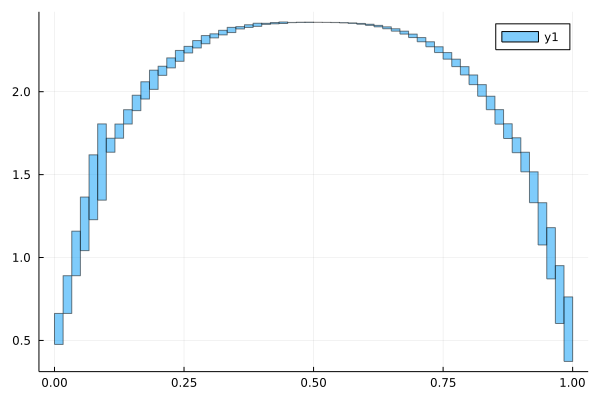

In [27]:
# naúočítat si vektor intervalů
# vypočítat hodnoty piconeho jako podíl 2 vektorů intervalů

# výpočet λ₁ - dolní odhad

# vykreslení řešení aproximovaného přes kubický spline


numer = Interval[]
#p = plot()#t, [λ1 for i in t])
for i in 1:length(u2i)-1
    x_dom = t[i]..t[i+1] # domain # range(0,1,length=n)
    x_int = mince(x_dom,xn)
    
    #u1_spl(x) = csc_u1[i][1]*(x-ti[i])^3 + csc_u1[i][2]*(x-ti[i])^2 + csc_u1[i][3]*(x-ti[i]) + csc_u1[i][4]

    #u2der_spl(x) = -(csc_u2der[i][1]*(x-ti[i])^2 + csc_u2der[i][2]*(x-ti[i]) + csc_u2der[i][3])
    f(x) = -(csc_u2der[i][1]*(x-ti[i])^2 + csc_u2der[i][2]*(x-ti[i]) + csc_u2der[i][3])
    #f(x)         = -(csc_u2der[i][1]*(x-ti[i])^2 + csc_u2der[i][2]*(x-ti[i]) + csc_u2der[i][3])    

    #f(x) = u2der_spl(x) / u1_spl(x) #^(P-1)
    #println(-v_spl_der_i(x_int[1]))
    #println(u_spl_i(x_int[1]))
    #boxes = IntervalBox.(x_int, f.(x_int))    
    
    #if i == length(u2i)-1
    #    println(u2der_spl(x_int[end]))
    #    println(u1_spl(x_int[end]))        
    #    println(boxes[end])
    #end
    
    #plot!(boxes, legend=false)
    # kromě vykreslení sem musím ještě dodat záznam minim
    append!(numer, f.(x_int))
    
end
#println("Dolní odhad λ₁: $(minimum(ls))")
#println("Chyba proti přesné hodnotě λ₁: $(λ1 - minimum(ls))")
plot(IntervalBox.(tints, numer))


In [98]:
plot(IntervalBox.(tints, numer), xlim=(0.0499,0.0501), ylim=(1.069,1.17))

In [100]:
tints[1000:end]

19041-element Vector{Interval{Float64}}:
 [0.0498502, 0.0499002]
 [0.0499001, 0.0499501]
 [0.04995, 0.0500001]
 [0.05, 0.05005]
 [0.0500499, 0.0500999]
 [0.0500998, 0.0501498]
 [0.0501497, 0.0501997]
 [0.0501996, 0.0502496]
 [0.0502495, 0.0502995]
 [0.0502994, 0.0503494]
 [0.0503493, 0.0503993]
 [0.0503992, 0.0504492]
 [0.0504491, 0.0504991]
  ⋮
 [0.999401, 0.999452]
 [0.999451, 0.999501]
 [0.9995, 0.999551]
 [0.99955, 0.999601]
 [0.9996, 0.999651]
 [0.99965, 0.999701]
 [0.9997, 0.999751]
 [0.99975, 0.999801]
 [0.9998, 0.999851]
 [0.99985, 0.999901]
 [0.9999, 0.999951]
 [0.99995, 1]

In [73]:
numer

20040-element Vector{Interval}:
 [0.475658, 0.476158]
 [0.476157, 0.476657]
 [0.476656, 0.477156]
 [0.477155, 0.477656]
 [0.477655, 0.478156]
 [0.478155, 0.478656]
 [0.478655, 0.479157]
 [0.479156, 0.479658]
 [0.479657, 0.480159]
 [0.480158, 0.480661]
 [0.48066, 0.481164]
 [0.481163, 0.481666]
 [0.481665, 0.482169]
  ⋮
 [0.478508, 0.47973]
 [0.477998, 0.47922]
 [0.477489, 0.478711]
 [0.47698, 0.478203]
 [0.476471, 0.477695]
 [0.475963, 0.477187]
 [0.475455, 0.476679]
 [0.474948, 0.476172]
 [0.474441, 0.475665]
 [0.473934, 0.475159]
 [0.473427, 0.474653]
 [0.472921, 0.474147]

In [77]:
f(x,y) = x / y^(P-1)
picone_tmp = f.(numer, u1int)

picone = Interval[100..100]
for i in 1:length(picone_tmp)-1
    append!(picone, picone_tmp[i] ∪ picone_tmp[i+1])
    
end


#boxes = IntervalBox.(tints, f.(numer, u1int))
boxes = IntervalBox.(tints, picone)
plot(boxes, ylim=(0,10))

In [102]:
plot(boxes, xlim=(0.0499,0.0501), ylim=(4.5,5.5))

In [79]:
println("Minimium na začátku: $(minimum(picone[1:3000]))")
println("Minimium na konci: $(minimum(picone[3000:end]))")
println("Chyba proti přesnému řešení: $(λ1-inf(minimum(picone)))")

Minimium na začátku: [4.8847, 4.89277]
Minimium na konci: [4.88225, 4.89525]
Chyba proti přesnému řešení: 0.43646335147656945


# KONEC
----

Intervalově vyjádříme $u_1$ z $u_2$ jako:

$$u_1(t) = \alpha + \int_0^t |u_2(s)|^{\frac{1}{p-1}}\text{sgn}\,u_2(s)\, ds$$

V intervalové aritmetice:

$$u_1(a..b) = \alpha + |u_2(a..b)|^{\frac{1}{p-1}}\text{sgn}\,u_2(a..b) * \text{diam}(a..b)$$

In [46]:
u1spl = Interval[0..0] # ∪ abs(u2spl[1])^(1/(P-1))*sign(u2spl[1])*diam(tints[1])
u1prev = 0..0

for i in 2:length(u2spl)#
   #append!(u1spl, abs(u2spl[i])^(1/(P-1))*sign(u2spl[i]))*diam(tints[i])

    u1_tmp = u1spl[end]+ abs(u2spl[i])^(1/(P-1))*sign(u2spl[i])*diam(tints[i])#u1spl[end] +abs(u2spl[i])^(1/(P-1))*sign(u2spl[i])*diam(tints[i])
   
    #println(u1_tmp ∩ u1spl[end])
    
    #if u1_tmp ∩ u1spl[end] == ∅
    #    println("$i JE PRAZDNÁ")
    #    if sup(u1spl[end]) <= inf(u1_tmp)
    #        u1_tmp = sup(u1spl[end])..sup(u1_tmp)
    #    else
    #        u1_tmp = sup(u1spl[end])..sup(u1_tmp)
    #    end
    #end
    #u1_tmp = sup(u1spl[end])..sup(u1_tmp)
    append!(u1spl, u1prev ∪ u1_tmp)
    u1prev = inf(u1_tmp)..sup(u1_tmp)
end
#bbb = IntervalBox.(tints, u1spl)
#plot(bbb)


In [47]:
bbb = IntervalBox.(tints, u1spl[1:end])
plot(bbb)

In [48]:
testu = Interval[]
for i in 1:length(u1spl)
   
end
testu

Interval[]

In [49]:
# i z u1spl udělat spline - tohle spíš ne, stačí ty intervaly

In [50]:
# derivovat u2spl

In [51]:
# dosadit do piconeho

Derivace $u_2$

In [52]:
csc_u2der =[ [@interval(3) * cs[1], @interval(2) * cs[2], cs[3]] for cs in csc_u2 ]

20-element Vector{Vector{Interval{Float64}}}:
 [[-173.404, -173.403], [0.00146708, 0.00146709], [-0.64215, -0.642149]]
 [[123.028, 123.029], [-17.339, -17.3389], [-1.0756, -1.07559]]
 [[-1.90938, -1.90937], [-5.03603, -5.03602], [-1.63498, -1.63497]]
 [[20.6694, 20.6695], [-5.22697, -5.22696], [-1.89155, -1.89154]]
 [[9.2029, 9.20291], [-3.16002, -3.16001], [-2.10123, -2.10122]]
 [[8.70712, 8.70713], [-2.23973, -2.23972], [-2.23622, -2.23621]]
 [[6.06296, 6.06297], [-1.36902, -1.36901], [-2.32644, -2.32643]]
 [[4.34055, 4.34056], [-0.762717, -0.762716], [-2.37973, -2.37972]]
 [[2.61061, 2.61062], [-0.328662, -0.328661], [-2.40702, -2.40701]]
 [[0.675879, 0.67588], [-0.0676001, -0.0676], [-2.41692, -2.41691]]
 [[0.676189, 0.67619], [-1.21157e-05, -1.21156e-05], [-2.41861, -2.4186]]
 [[2.61052, 2.61053], [0.0676068, 0.0676069], [-2.41692, -2.41691]]
 [[4.34057, 4.34058], [0.328659, 0.32866], [-2.40702, -2.40701]]
 [[6.06296, 6.06297], [0.762717, 0.762718], [-2.37973, -2.37972]]
 [[8.7071

In [53]:
# vykreslení řešení aproximovaného přes kubický spline

xn = 3

p = plot()
for i in 1:length(u2i)-1
    x_dom = t[i]..t[i+1] # domain # range(0,1,length=n)
    x_int = mince(x_dom,xn)
    jmenovatel(x) = csc_u1[i][1]*(x-ti[i])^3 + csc_u1[i][2]*(x-ti[i])^2 + csc_u1[i][3]*(x-ti[i]) + csc_u1[i][4]
    f(x) = -(csc_u2der[i][1]*(x-ti[i])^2 + csc_u2der[i][2]*(x-ti[i]) + csc_u2der[i][3])
    g(x) = f(x)/jmenovatel(x)
    boxes = IntervalBox.(x_int, g.(x_int))    
    if i == length(u2i)-1
        println(boxes[end])
    end
    plot!(boxes, legend=false)
end
p

LoadError: UndefVarError: csc_u1 not defined

In [54]:
# výpočet λ₁ - dolní odhad

# vykreslení řešení aproximovaného přes kubický spline

ls = []

xn = 10

p = plot(t, [λ1 for i in t])
for i in 1:length(u2i)-1
    x_dom = t[i]..t[i+1] # domain # range(0,1,length=n)
    x_int = mince(x_dom,xn)
    
    u1_spl(x) = csc_u1[i][1]*(x-ti[i])^3 + csc_u1[i][2]*(x-ti[i])^2 + csc_u1[i][3]*(x-ti[i]) + csc_u1[i][4]

    u2der_spl(x) = -(csc_u2der[i][1]*(x-ti[i])^2 + csc_u2der[i][2]*(x-ti[i]) + csc_u2der[i][3])
    #f(x)         = -(csc_u2der[i][1]*(x-ti[i])^2 + csc_u2der[i][2]*(x-ti[i]) + csc_u2der[i][3])    

    f(x) = u2der_spl(x) / u1_spl(x) #^(P-1)
    #println(-v_spl_der_i(x_int[1]))
    #println(u_spl_i(x_int[1]))
    boxes = IntervalBox.(x_int, f.(x_int))    
    
    if i == length(u2i)-1
        println(u2der_spl(x_int[end]))
        println(u1_spl(x_int[end]))        
        println(boxes[end])
    end
    
    plot!(boxes, legend=false)
    # kromě vykreslení sem musím ještě dodat záznam minim
    append!(ls, inf.(f.(x_int)))
    
end
println("Dolní odhad λ₁: $(minimum(ls))")
println("Chyba proti přesné hodnotě λ₁: $(λ1 - minimum(ls))")
p


LoadError: UndefVarError: csc_u1 not defined

# Spline přes DataInterpolations.jl

- neumi ale nastavit druhou derivaci na koncích, navíc to neni intervalově :-(

In [55]:
# proložení splinem - pomocí DataInterpolations
# tady si ale nejsem schopen nastavit správně krajní záporné druhé derivace

u_spl = CubicSpline(u1,t);
v_spl = CubicSpline(u2,t);


LoadError: UndefVarError: u1 not defined

In [56]:
#vykreslení funkce intervalově
x_dom = 0..1
x_int = mince(x_dom,100)

boxes_u = IntervalBox.(x_int, u_spl.(x_int))
boxes_v = IntervalBox.(x_int, v_spl.(x_int))
plot(boxes_u)
plot!(boxes_v)

LoadError: UndefVarError: u_spl not defined

In [57]:
v_spl_der(x) = ForwardDiff.derivative(v_spl,x)

v_spl_der (generic function with 1 method)

In [58]:
x_dom = 0..1
x_int = mince(x_dom,100)

boxes = IntervalBox.(x_int, v_spl_der.(x_int))
plot(boxes)

LoadError: UndefVarError: v_spl not defined

In [59]:
l_low(x) = -v_spl_der(x) / u_spl(x)^(P-1)

l_low (generic function with 1 method)

In [60]:
x_dom = 0..1
x_int = mince(x_dom,200)

boxes = IntervalBox.(x_int, l_low.(x_int))
plot(t, [λ1 for i in t])
plot!(boxes)


LoadError: UndefVarError: v_spl not defined

In [61]:
l_low(0..1)

LoadError: UndefVarError: v_spl not defined